In [9]:
import matplotlib.pyplot as plt
import numpy as np
import math

In [6]:
class GeneticAlgorithm:
  def __init__(self, size_poblation, generations, ind_size, genetic_pool, prob) -> None:
    self.size_poblation = size_poblation
    self.generations = generations
    self.ind_size = ind_size
    self.genetic_pool = genetic_pool
    self.prob = prob

  def fx(self, x):
    return -(0.1+(1-x)**2-0.1*math.cos(6*math.pi*(1-x)))+2
    # return math.sin(x)
  

  def plot_population(self, population, generation):
    plt.figure(figsize=(8, 6))
    # x = np.linspace(0, 2, 1000)
    # plt.plot(x, y, label='Función objetivo')
    hola = self.listToDecimal(population[0])
    print(hola)
    x_individual = np.linspace(0, 2, 40)
    y_individual = np.array(hola)

    plt.scatter(x_individual, y_individual, label='Individuo', color='red')
    plt.plot(x_individual, y_individual, '--', alpha=0.3)

    plt.title(f'Generación {generation}')
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.legend()
    plt.show()


  def initializePopulation(self):
    poblation = []

    for i in range(self.size_poblation):
      individual = []
      for j in range(self.ind_size):
        gen = []
        gen += [np.random.choice(self.genetic_pool[0])]
        gen += list(np.random.choice(self.genetic_pool[1], self.ind_size - 1))
        individual.append(gen)
      poblation.append(individual)

    return poblation


  def domainToSample(self,size_sampling):
    sampling = []

    for dom in range(size_sampling):
      sampling.append((dom + 1) * 0.05)

    return sampling


  def mse(self, fitting_fun):
    sampling = self.domainToSample(len(fitting_fun))
    initial_fun = list(map(self.fx,sampling))

    mse = np.mean((np.array(initial_fun) - np.array(fitting_fun)) ** 2)
    return mse
    

  def listToDecimal(self, individual):
    result = []

    for sublist in individual:
      integer_part = sublist[0]
      decimal_part = sublist[1:]
      combined_value = float(f"{integer_part}.{''.join(map(str, decimal_part))}")
      result.append(combined_value)

    return result


  def fitness(self, poblation):
    fitness = []

    for individual in poblation:
      x = self.listToDecimal(individual)
      probability = 2 - self.mse(x)
      fitness.append(probability)

    fitness = np.array(fitness)
    fitness = fitness / fitness.sum()
    return fitness


  def crossover(self, poblation, fitness):
    offspring = []

    for i in range(self.size_poblation//2):
      parents = np.random.choice(self.size_poblation, 2, p=fitness)
      cross_point = np.random.randint(self.ind_size)
      offspring += [poblation[parents[0]][:cross_point] + poblation[parents[1]][cross_point:]]
      offspring += [poblation[parents[1]][:cross_point] + poblation[parents[0]][cross_point:]]

    return offspring

  def mutate(self, individuals):
    
    for i in range(len(individuals)):
      mutate_individual = individuals[i]

      for j in range(len(mutate_individual)):
        gen = mutate_individual[j]

        if (np.random.random() < self.prob):
          mutation = np.random.choice(self.genetic_pool[1])
          gen[1] = mutation

        mutate_individual[j] = gen
      
      individuals[i] = mutate_individual

    return individuals
  

  def evolvePopulation(self):
    initial_values = self.initializePopulation()
    sampling = self.domainToSample(10)
    initial_fun = list(map(self.fx,sampling))
    print(initial_fun)
    for generation in range(self.generations):
      fitness = []
      fitness = self.fitness(initial_values)
      offspring = self.crossover(initial_values, fitness)
      #initial_values = offspring
      initial_values = self.mutate(offspring)
    self.plot_population(initial_values, generation)
    
    pepe = []
    for individual in initial_values:
      y = self.listToDecimal(individual)
      pepe.append(y)

    return pepe
    
    
    

[1.056278525229247, 1.0590983005625052, 1.0823943483704848, 1.1790983005625053, 1.3375, 1.4909016994374948, 1.5726056516295155, 1.5709016994374947, 1.5387214747707525, 1.55]
[0.8463549226145262, 1.1648277027260585, 1.3136106832543526, 1.9103130997246742, 1.1110556300865784, 1.6711155619372908, 1.446798099844949, 1.2637795752246714, 1.3954595584577287, 1.9123450163568845, 1.236466681758802, 1.187342652551537, 1.4008475751221532, 1.6889603986438066, 1.8936165643512908, 1.9831887461732673, 1.9529302612404331, 1.8715525236547617, 1.7494027410927169, 1.3169809624055893, 1.3249931391414878, 1.1017547203514941, 1.083517143743778, 1.7419243541744873, 1.2738416588519383, 1.2465923148163705, 1.4769936040298255, 1.6774614314799399, 1.2736188006829816, 1.3983509027887322, 1.8279061051545478, 1.2312354752842416, 1.6109834202300681, 1.655976047113319, 1.7384604919387436, 1.2216945534322388, 1.6685450188878133, 0.30841508562063247, 1.5034427390267135, 1.087944766072326]


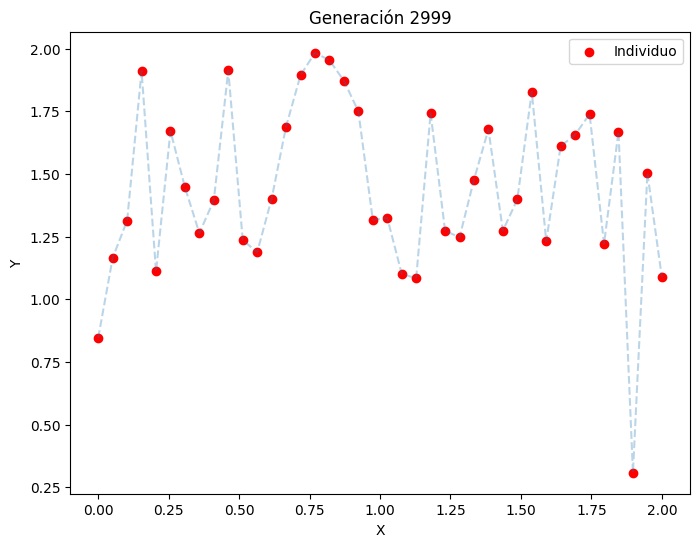

[[0.8463549226145262,
  1.1648277027260585,
  1.3136106832543526,
  1.9103130997246742,
  1.1110556300865784,
  1.6711155619372908,
  1.446798099844949,
  1.2637795752246714,
  1.3954595584577287,
  1.9123450163568845,
  1.236466681758802,
  1.187342652551537,
  1.4008475751221532,
  1.6889603986438066,
  1.8936165643512908,
  1.9831887461732673,
  1.9529302612404331,
  1.8715525236547617,
  1.7494027410927169,
  1.3169809624055893,
  1.3249931391414878,
  1.1017547203514941,
  1.083517143743778,
  1.7419243541744873,
  1.2738416588519383,
  1.2465923148163705,
  1.4769936040298255,
  1.6774614314799399,
  1.2736188006829816,
  1.3983509027887322,
  1.8279061051545478,
  1.2312354752842416,
  1.6109834202300681,
  1.655976047113319,
  1.7384604919387436,
  1.2216945534322388,
  1.6685450188878133,
  0.30841508562063247,
  1.5034427390267135,
  1.087944766072326],
 [0.8463549226145262,
  1.1648277027260585,
  1.3136106832543526,
  1.9103130997246742,
  1.1110556300865784,
  1.6711155619

In [7]:
size_poblation = 300
ind_size = 40
generations = 3000
genetic_pool = [[0,1], [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]]
prob = 0.00005

mi_funcion = GeneticAlgorithm(size_poblation,generations, ind_size, genetic_pool, prob)
mi_funcion.evolvePopulation()

In [13]:
from scipy.interpolate import make_interp_spline
class GeneticAlgorithm:
  def __init__(self, size_poblation, generations, ind_size, genetic_pool, prob) -> None:
    self.size_poblation = size_poblation
    self.generations = generations
    self.ind_size = ind_size
    self.genetic_pool = genetic_pool
    self.prob = prob

  def fx(self, x):
    return math.sin(x)
  
  def plot_func(self):
    plt.figure(figsize=(8, 6))
    x = np.linspace(0, 16, 80)
    y = list(map(self.fx,x))
    plt.plot(x, y, label='Función objetivo')

    plt.title(f'Función objetivo')
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.legend()
    plt.show()

  def plot_population(self, population, generation):
    plt.figure(figsize=(8, 6))
    # x = np.linspace(0, 16, 80)
    # y = list(map(self.fx,x))
    # plt.plot(x, y, label='Función objetivo')


    fit_func = self.listToDecimal(population[0])
    x_individual = np.linspace(0, 16, 80)
    y_individual = np.array(fit_func)

    plt.scatter(x_individual, y_individual, label='Individuo', color='red')
    # plt.plot(x_individual, y_individual, 'o', alpha=0.3)

    # Crear una curva suave
    spl = make_interp_spline(x_individual, y_individual, k=3)  # k=3 para una curva suave
    x_smooth = np.linspace(x_individual.min(), x_individual.max(), 1000)
    y_smooth = spl(x_smooth)

    # Dibujar la curva suave
    plt.plot(x_smooth, y_smooth, label='Curva suave', color='red')

    plt.title(f'Generación {generation}')
    plt.xlabel('X')
    plt.ylabel('Y')
    plt.legend()
    plt.show()


  def initializePopulation(self):
    poblation = []

    for i in range(self.size_poblation):
      individual = []
      for j in range(self.ind_size):
        gen = []
        gen += [np.random.choice(self.genetic_pool[0])]
        gen += list(np.random.choice(self.genetic_pool[1], self.ind_size - 1))
        individual.append(gen)
      poblation.append(individual)

    return poblation


  def domainToSample(self,size_sampling):
    sampling = []

    for dom in range(size_sampling):
      sampling.append((dom + 1) * 0.2)

    return sampling


  def mse(self, fitting_fun):
    sampling = self.domainToSample(len(fitting_fun))
    initial_fun = list(map(self.fx,sampling))

    mse = np.mean((np.array(initial_fun) - np.array(fitting_fun)) ** 2)
    return mse
    

  def listToDecimal(self, individual):
    result = []

    for sublist in individual:
      integer_part = sublist[0]
      decimal_part = sublist[1:]
      combined_value = float(f"{integer_part}.{''.join(map(str, decimal_part))}")
      result.append(combined_value)
    return result


  def fitness(self, poblation):
    fitness = []

    for individual in poblation:
      x = self.listToDecimal(individual)
      probability = np.abs(1 - self.mse(x))
      print(self.mse(x))
      fitness.append(probability)

    fitness = np.array(fitness)
    fitness = fitness / fitness.sum()
    return fitness


  def crossover(self, poblation, fitness):
    offspring = []

    for i in range(self.size_poblation//2):
      parents = np.random.choice(self.size_poblation, 2, p=fitness)
      cross_point = np.random.randint(self.ind_size)
      offspring += [poblation[parents[0]][:cross_point] + poblation[parents[1]][cross_point:]]
      offspring += [poblation[parents[1]][:cross_point] + poblation[parents[0]][cross_point:]]

    return offspring

  def evolvePopulation(self):
    initial_values = self.initializePopulation()
    self.plot_func()
    self.plot_population(initial_values,0)
    for generation in range(self.generations):
      fitness = []
      fitness = self.fitness(initial_values)
      offspring = self.crossover(initial_values, fitness)
      initial_values = offspring
    self.plot_population(initial_values, generation)
    
    pepe = []
    for individual in initial_values:
      y = self.listToDecimal(individual)
      pepe.append(y)


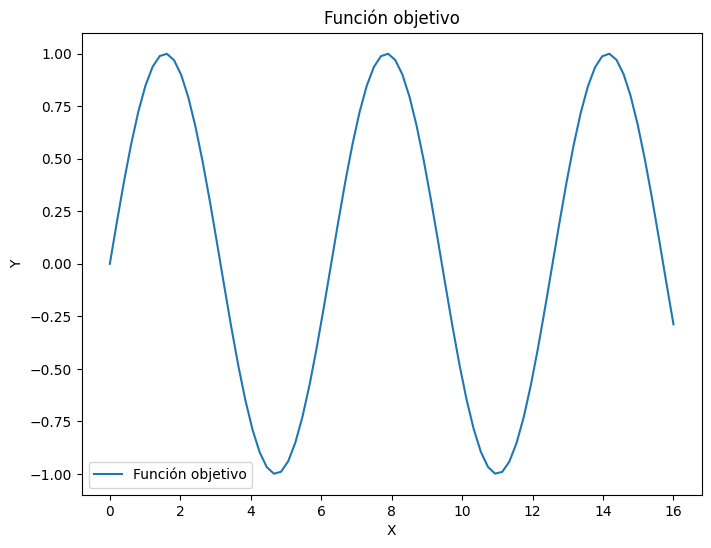

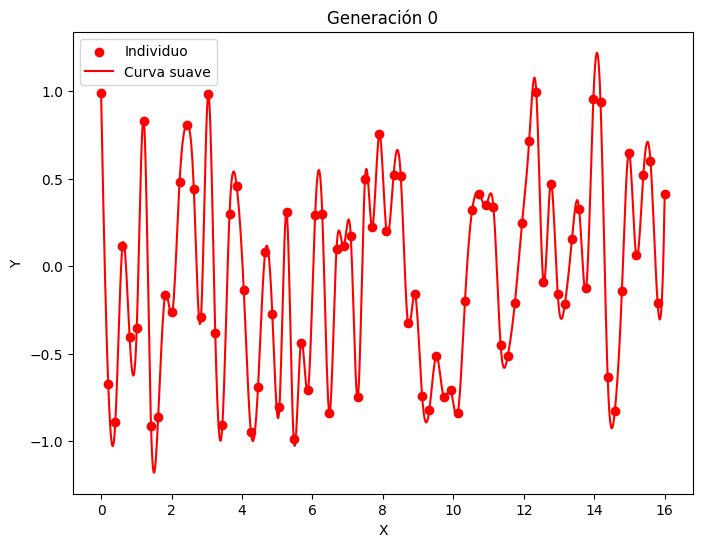

0.6942087701601515
0.9245629296428174
0.8454909692664149
1.0051831112223617
0.9058398675274084
0.8208430447216953
0.8859413860945459
0.9033235024310097
0.7549458615586904
0.7498851385433193
0.9055035893299059
0.743841720681027
1.00072717830782
0.7027493557757045
0.6120659293158955
0.9074153631201008
0.9960474467294651
0.9084220641704774
0.7120199972054768
0.9954820035479408
0.8739076560314342
0.8725930887014919
0.8219193755312876
0.9194953215893946
0.7724758073244493
0.8257309186417251
0.6929318627539899
1.0813803411806382
0.8250417034071758
0.9033811076090581
0.7558568710864131
0.9073387510342583
0.8347567332738768
0.8349405209602876
0.862013434341554
0.8200608408990812
0.9345956320097393
1.0198265487854912
0.8642148857728887
0.8505311209812415
0.7958083734520814
0.7049037075249077
0.8185410962549244
0.9000431851120496
0.9272600148227831
0.9741991617585496
0.9167258513723036
0.9326516232365233
0.7894288116749231
0.7402830327056408
0.8501757725700549
0.797973819355691
0.813173226852573

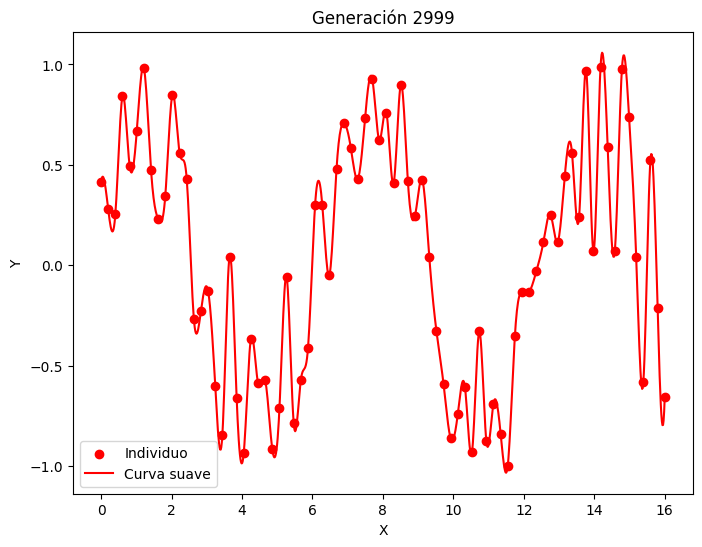

In [14]:
size_poblation = 300
ind_size = 80
generations = 3000
genetic_pool = [["0","-0"], [0, 1, 2, 3, 4, 5, 6, 7, 8, 9]]
prob = 0.00005

mi_funcion = GeneticAlgorithm(size_poblation,generations, ind_size, genetic_pool, prob)
mi_funcion.evolvePopulation()